# **Exercice 1: Prédiction**

**Importation du module Base, deployé dans un repo Github personnel**

In [ ]:
!git clone https://github.com/rdmn/reinforcement-learning.git
%cd reinforcement-learning/

Cloning into 'reinforcement-learning'...
remote: Enumerating objects: 6, done.
remote: Counting objects: 100% (6/6), done.
remote: Compressing objects: 100% (4/4), done.
remote: Total 6 (delta 0), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (6/6), done.
/content/reinforcement-learning


In [ ]:
import base
import numpy as np
import math
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

In [ ]:
env = base.Maze() # FrozenLake44 / FoorRooms_Key
env.render()

■ ■ ■ ■ ■ ■ 
■ X _ _ G ■
■ _ ■ _ ■ ■
■ _ _ _ ■ ■
■ _ ■ _ F ■
■ ■ ■ ■ ■ ■ 



### **Utilities pour l'exercice 1**

In [ ]:
def compute_q(values, env, gamma):
    return np.sum(env.p() * (env.r() + gamma * values[None, None, :]), axis=2)

def greedy(values, env, gamma):
    ns = env.get_nb_states()
    q = compute_q(values, env, gamma)
    policy = np.zeros((env.get_nb_states(), env.get_nb_actions()))
    best_action = np.argmax(q, axis=1)
    np.put_along_axis(policy, best_action[:,None], np.ones(ns)[:,None], axis=1)

    return policy

def ipe(pi, env, gamma, epsilon=0.01):
    v = np.zeros((env.get_nb_states()))
    q = compute_q(v, env, gamma)
    nv = np.sum(pi * q, axis=1)

    while(np.sum(np.abs(nv - v)) > epsilon):
        v = nv
        q = compute_q(v, env, gamma)
        nv = np.sum(pi * q, axis=1)

    return nv

def iterative_policy(env, gamma, epsilon=0.01):
    ns = env.get_nb_states()
    na = env.get_nb_actions()
    policy = np.tile(np.array([0.1, 0.4, 0.4, 0.1]), (env.get_nb_states(),1) )
    nv = ipe(policy, env, gamma, epsilon)
    npolicy = greedy(nv, env, gamma)

    while(np.sum(np.abs(npolicy - policy)) > epsilon):
        policy = npolicy
        nv = ipe(policy, env, gamma, epsilon)
        npolicy = greedy(nv, env, gamma)

    return npolicy

## **Q1**
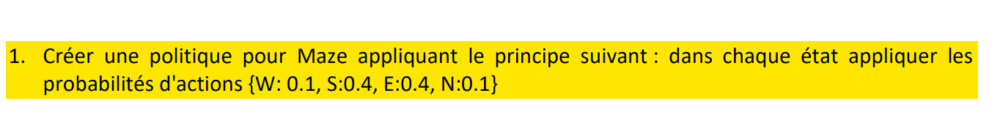

Nous allons trouver créer une politique, pour les probabilité d'actions données, <br> çi dessous est un exemple d'une politique aléatoire, utilisant les transitions données: 

In [ ]:
env = base.Maze()
policy = np.tile([0.1,0.4,0.4,0.1], (env.get_nb_states(), 1))
state = env.reset()
terminal = False

while not terminal:
    action = np.random.choice(4, p=policy[state])
    state, reward, terminal, info = env.step(action)
    env.render()

print("Récompense finale est: ", reward)

■ ■ ■ ■ ■ ■ 
■ A X _ G ■
■ _ ■ _ ■ ■
■ _ _ _ ■ ■
■ _ ■ _ F ■
■ ■ ■ ■ ■ ■ 

■ ■ ■ ■ ■ ■ 
■ A X _ G ■
■ _ ■ _ ■ ■
■ _ _ _ ■ ■
■ _ ■ _ F ■
■ ■ ■ ■ ■ ■ 

■ ■ ■ ■ ■ ■ 
■ A X _ G ■
■ _ ■ _ ■ ■
■ _ _ _ ■ ■
■ _ ■ _ F ■
■ ■ ■ ■ ■ ■ 

■ ■ ■ ■ ■ ■ 
■ A _ X G ■
■ _ ■ _ ■ ■
■ _ _ _ ■ ■
■ _ ■ _ F ■
■ ■ ■ ■ ■ ■ 

■ ■ ■ ■ ■ ■ 
■ A _ _ G ■
■ _ ■ X ■ ■
■ _ _ _ ■ ■
■ _ ■ _ F ■
■ ■ ■ ■ ■ ■ 

■ ■ ■ ■ ■ ■ 
■ A _ _ G ■
■ _ ■ X ■ ■
■ _ _ _ ■ ■
■ _ ■ _ F ■
■ ■ ■ ■ ■ ■ 

■ ■ ■ ■ ■ ■ 
■ A _ _ G ■
■ _ ■ X ■ ■
■ _ _ _ ■ ■
■ _ ■ _ F ■
■ ■ ■ ■ ■ ■ 

■ ■ ■ ■ ■ ■ 
■ A _ _ G ■
■ _ ■ X ■ ■
■ _ _ _ ■ ■
■ _ ■ _ F ■
■ ■ ■ ■ ■ ■ 

■ ■ ■ ■ ■ ■ 
■ A _ _ G ■
■ _ ■ _ ■ ■
■ _ _ X ■ ■
■ _ ■ _ F ■
■ ■ ■ ■ ■ ■ 

■ ■ ■ ■ ■ ■ 
■ A _ _ G ■
■ _ ■ _ ■ ■
■ _ _ _ ■ ■
■ _ ■ X F ■
■ ■ ■ ■ ■ ■ 

■ ■ ■ ■ ■ ■ 
■ A _ _ G ■
■ _ ■ _ ■ ■
■ _ _ _ ■ ■
■ _ ■ _ X ■
■ ■ ■ ■ ■ ■ 

Récompense finale est:  1000.0


On peut aussi utiliser, la techniques de la politique itérative pour trouver une <br> une politique optimale aboutissant à l'état final:

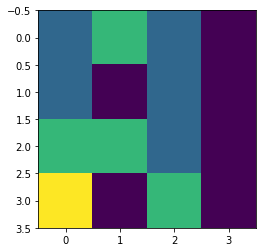

■ ■ ■ ■ ■ ■ 
■ A _ _ G ■
■ X ■ _ ■ ■
■ _ _ _ ■ ■
■ _ ■ _ F ■
■ ■ ■ ■ ■ ■ 

■ ■ ■ ■ ■ ■ 
■ A _ _ G ■
■ _ ■ _ ■ ■
■ X _ _ ■ ■
■ _ ■ _ F ■
■ ■ ■ ■ ■ ■ 

■ ■ ■ ■ ■ ■ 
■ A _ _ G ■
■ _ ■ _ ■ ■
■ _ X _ ■ ■
■ _ ■ _ F ■
■ ■ ■ ■ ■ ■ 

■ ■ ■ ■ ■ ■ 
■ A _ _ G ■
■ _ ■ _ ■ ■
■ _ _ X ■ ■
■ _ ■ _ F ■
■ ■ ■ ■ ■ ■ 

■ ■ ■ ■ ■ ■ 
■ A _ _ G ■
■ _ ■ _ ■ ■
■ _ _ _ ■ ■
■ _ ■ X F ■
■ ■ ■ ■ ■ ■ 

■ ■ ■ ■ ■ ■ 
■ A _ _ G ■
■ _ ■ _ ■ ■
■ _ _ _ ■ ■
■ _ ■ _ X ■
■ ■ ■ ■ ■ ■ 

Récompense finale est:  1000.0


In [ ]:
state = env.reset()
policy = iterative_policy(env, 0.9, 0.01)
env.render_policy_img(policy)

terminal = False
while not terminal:
    action = np.random.choice(4, p=policy[state])
    state, reward, terminal, info = env.step(action)
    env.render()

print("Récompense finale est: ", reward)

## **Q2**

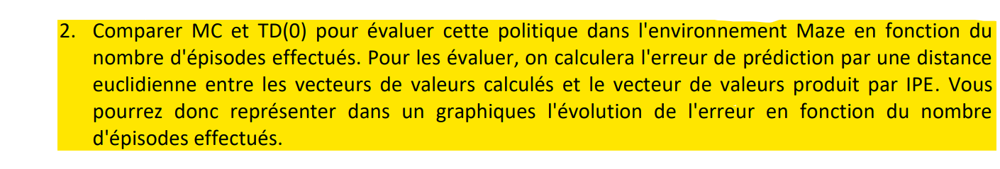

In [ ]:
# Retour à la politique initiale (uniforme)
policy1 = np.tile([0.1,0.4,0.4,0.1], (env.get_nb_states(), 1))

**Implementation de TD(0)**

In [ ]:
def TD_0(env, policy, gamma, nb_episodes, alpha=0.1):
    state = env.reset()
    predictions = []
    deltas = []
    nb_actions = env.get_nb_actions()
    nbstates = env.get_nb_states()

    # Boucle d'exploration
    for ne in range(nb_episodes):

        state = env.reset()
        episode = []
        done = False

        # Crétation d'un épisode sur lequel on va faire la Mise à jour de v
        while not done:
            action = np.random.choice(nb_actions, p=policy[state])
            ns, renf, done, _ = env.step(action)
            episode.append([state, action, ns, renf])
            state = ns

        v = np.zeros((nbstates))

        # MAJ des valeurs d'états
        for s, a, ns, r in reversed(episode):
            target = r + gamma * v[ns]
            delta = target - v[s]
            v[s] = v[s] + alpha * delta
            deltas.append(delta)

        predictions.append(v)

    return v, predictions, deltas

**Implementation de MC (Monte-Carlo) pour la prédiciton**



In [ ]:
def monte_carlo(env, policy, gamma, nb_episodes):

    state = env.reset()
    nbactions = env.get_nb_actions()
    nbstates = env.get_nb_states()
    v = np.zeros((nbstates))

    predictions = []
    
    for ne in range(nb_episodes):
        # Générer un épisode
        episode = []
        state = env.reset()
        final = False

        while not final:
            action = np.random.choice(nbactions, p=policy[state])
            ns, renf, final, _ = env.step(action)
            episode.append([state, action, ns, renf])
            state = ns
        
        # Mettre à jour les valeurs
        retour = 0
        # Compteur d'états N(state)
        compteur = np.zeros((nbstates))
        # Somme des valeurs d'états
        somme = np.zeros((env.get_nb_states()))
        for s, a, ns, r in reversed(episode):
            retour = r + gamma * retour
            compteur[s] += 1
            somme[s] += retour

        v = somme.copy()
        for s in range(nbstates):
            if compteur[s] > 0:
                v[s] /= compteur[s]

        predictions.append(v)

    return v, predictions

**Implémentation de TD(lambda):**

In [ ]:
def TD_lambda(env, policy, gamma, lambda_, nb_episodes, alpha=0.1):

    state = env.reset()
    nbactions = env.get_nb_actions()
    nbstates = env.get_nb_states()
    predictions = []
    deltas = []

    for ne in range(nb_episodes):

        episode = []
        state = env.reset()
        final = False

        # Génerer un épisode sur lequel on peut appliquer la MAJ
        while not final:
            action = np.random.choice(nbactions, p=policy[state])
            ns, renf, final, _ = env.step(action)
            episode.append([state, action, ns, renf])
            state = ns

        compteur = np.zeros((nbstates)) # compteur d'états
        value = np.zeros((nbstates)) # somme des valeurs d'états

        for s, a, ns, r in reversed(episode):

            error = r + gamma * value[ns] - value[s]
            deltas.append(error)

            for st in range(nbstates) :
                if  st == s:
                    compteur[s] = 1 + gamma * lambda_ * compteur[s]
                else : 
                    compteur[s] = gamma * lambda_ * compteur[s]

            value = value + alpha * (error) * compteur

        predictions.append(value)

    return value, predictions, deltas

**Calcul de politique en utilisant l'algorithme IPE:**

In [ ]:
va_estimate = ipe(policy1, env, 0.5)

**Comparaison entre TD(0) et MC p/p à l'évolution de l'erreur de prediction**

In [ ]:
nb_ep = 100
gamma = 0.9
lambda_ = [0.1, 0.3, 0.5] # On peut varier Gamma

v1, predictions1, _ = TD_0(env, policy1, gamma, nb_episodes=nb_ep)
v2, predictions2 = monte_carlo(env, policy1, gamma, nb_ep)
v3, predictions3, _ = TD_lambda(env, policy1, gamma, lambda_[2], nb_ep)

In [ ]:
fig = make_subplots(rows=3, cols=1, y_title='Érreur prédiction de V')
bool_ = True


_, predictions11, _ = TD_0(env, policy1, gamma, nb_episodes=50)
_, predictions12, _ = TD_0(env, policy1, gamma, nb_episodes=100)
_, predictions13, _ = TD_0(env, policy1, gamma, nb_episodes=200)

errors_td01 = [np.linalg.norm(va_estimate-x) for x in predictions11] 
errors_td02 = [np.linalg.norm(va_estimate-x) for x in predictions12]
errors_td03 = [np.linalg.norm(va_estimate-x) for x in predictions13]

fig.add_trace(go.Scatter(x=list(range(len(errors_td01))), y=errors_td01, name="Error TD0 (50 Ep)", marker=dict(color='rgb(220,20,60)'), showlegend=bool_), row=1, col=1)
fig.add_trace(go.Scatter(x=list(range(len(errors_td02))), y=errors_td02, name="Error TD0 (100 Ep)", marker=dict(color='rgb(0,0,240)'), showlegend=bool_), row=2, col=1)
fig.add_trace(go.Scatter(x=list(range(len(errors_td03))), y=errors_td03, name="Error TD0 (200 Ep)", marker=dict(color='rgb(78,220,0)'), showlegend=bool_), row=3, col=1)

fig.update_layout(height=700, width=900, 
                  plot_bgcolor='rgb(247,247,247)', 
                  title_text="Érreur prédiction de V de TD0 pour plusieurs valuers de Nbr épisodes")
fig['layout']['xaxis']['title']='Nbr Épisodes'
fig['layout']['xaxis2']['title']='Nbr Épisodes'
fig['layout']['xaxis3']['title']='Nbr Épisodes'

fig.show()

In [ ]:
fig = make_subplots(rows=2, cols=2, y_title='Érreur prédiction de V')

bool_ = True

v1, predictions1, _ = TD_0(env, policy1, gamma, nb_episodes=nb_ep)
v2, predictions2 = monte_carlo(env, policy1, gamma, nb_ep)
v3, predictions3, _ = TD_lambda(env, policy1, gamma, lambda_[2], nb_ep)
errors_td0 = [np.linalg.norm(va_estimate-x) for x in predictions1] 
errors_mc = [np.linalg.norm(va_estimate-x) for x in predictions2]
errors_tdlam = [np.linalg.norm(va_estimate-x) for x in predictions3]


fig.add_trace(go.Scatter(x=list(range(len(errors_td0))), y=errors_td0, name="Error TD0", marker=dict(color='rgb(220,20,60)'), showlegend=bool_), row=1, col=1)
fig.add_trace(go.Scatter(x=list(range(len(errors_mc))), y=errors_mc, name="Error MC", marker=dict(color='rgb(0,0,240)'), showlegend=bool_), row=1, col=2)
fig.add_trace(go.Scatter(x=list(range(len(errors_tdlam))), y=errors_tdlam, name="Error TD(Lambda)", marker=dict(color='rgb(78,220,0)'), showlegend=bool_), row=2, col=1)


fig.update_layout(height=600, width=1500, 
                  plot_bgcolor='rgb(247,247,247)', 
                  title_text="l'évolution de l'erreur de prediction de TD0, MC et TD(Lambda=0.5)")

fig['layout']['xaxis']['title']='Nbr Épisodes'
fig['layout']['xaxis2']['title']='Nbr Épisodes'
fig['layout']['xaxis3']['title']='Nbr Épisodes'

fig.show()

In [ ]:
fig = make_subplots(rows=2, cols=2, y_title='Érreur prédiction de V')

bool_ = True

v1, predictions1, _ = TD_lambda(env, policy1, gamma, lambda_[0], nb_ep)
v2, predictions2, _ = TD_lambda(env, policy1, gamma, lambda_[1], nb_ep)
v3, predictions3, _ = TD_lambda(env, policy1, gamma, lambda_[2], nb_ep)
errors_tdlam1 = [np.linalg.norm(va_estimate-x) for x in predictions1] 
errors_tdlam2 = [np.linalg.norm(va_estimate-x) for x in predictions2]
errors_tdlam3 = [np.linalg.norm(va_estimate-x) for x in predictions3]


fig.add_trace(go.Scatter(x=list(range(len(errors_tdlam1))), y=errors_tdlam1, name="Error TD(Lambda=0.1)", marker=dict(color='rgb(220,20,60)'), showlegend=bool_), row=1, col=1)
fig.add_trace(go.Scatter(x=list(range(len(errors_tdlam2))), y=errors_tdlam2, name="Error TD(Lambda=0.3)", marker=dict(color='rgb(0,0,240)'), showlegend=bool_), row=1, col=2)
fig.add_trace(go.Scatter(x=list(range(len(errors_tdlam3))), y=errors_tdlam3, name="Error TD(Lambda=0.5)", marker=dict(color='rgb(78,220,0)'), showlegend=bool_), row=2, col=1)


fig.update_layout(height=450, width=1500, 
                  plot_bgcolor='rgb(247,247,247)', 
                  title_text="l'évolution de l'erreur de prediction de TD(Lambda) pour plusieurs valeurs de Lambda")

fig['layout']['xaxis']['title']='Nbr Épisodes'
fig['layout']['xaxis2']['title']='Nbr Épisodes'
fig['layout']['xaxis3']['title']='Nbr Épisodes'

fig.show()

In [ ]:
fig = make_subplots(rows=2, cols=1, y_title='Erreur delta de lors la MAJ de V')

bool_ = True

_, _, deltas1 =  TD_0(env, policy1, gamma, nb_episodes=nb_ep)
_, _, deltas2 =  TD_lambda(env, policy1, gamma, lambda_[2], nb_ep)

fig.add_trace(go.Scatter(x=list(range(len(deltas1))), y=deltas1, name="Error delta TD0", marker=dict(color='rgb(220,20,60)'), showlegend=bool_), row=1, col=1)
fig.add_trace(go.Scatter(x=list(range(len(deltas2))), y=deltas2, name="Error delta TD(Lambda=0.5)", marker=dict(color='rgb(0,0,240)'), showlegend=bool_), row=2, col=1)


fig.update_layout(height=450, width=1900, 
                  plot_bgcolor='rgb(247,247,247)', 
                  title_text="l'évolution de l'erreur delta de lors la MAJ de V pour TD0 et TD(Lambda)")

fig['layout']['xaxis']['title']='Nbr Actions'
fig['layout']['xaxis2']['title']='Nbr Actions'

fig.show()

## **Q3**

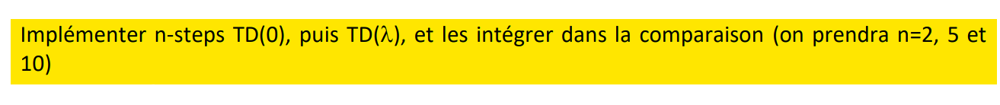

**Implémentation de TD-NStep**

In [ ]:
def td_nstep(env, policy, gamma, nb_episodes, alpha=0.01, n=2):

    state = env.reset()
    nbactions = env.get_nb_actions()
    nbstates = env.get_nb_states()

    predictions = []
    deltas = []
    
    for ne in range(nb_episodes):

        # Générer un épisode
        episode = []
        state = env.reset()
        final = False

        while not final:
            action = np.random.choice(nbactions, p=policy[state])
            ns, renf, final, _ = env.step(action)
            episode.append([state, action, ns, renf])
            state = ns

        # MAJ des valeurs d'états
        retour = 0
        value = np.zeros((nbstates)) # somme des valeurs d'états
        reward = []
        v_states = []
        nb_iter = 0
        for s, a, ns, r in reversed(episode):
            if  nb_iter <= n :
                G = r + sum(reward) 
            else:
                G  =  r + sum( [(gamma ** (i+1)) * rew for i,rew in enumerate(reversed(reward[0:(n)])) ] )  
                G = G + (gamma**(n+1)) *  v_states[-(n+1)] 

            value[s] = value[s]  + alpha * (G - value[s])
            v_states.append(value[s])
            reward.append(r)
            nb_iter +=1

            deltas.append(G - value)

        predictions.append(value)

    return value, predictions, deltas

In [ ]:
fig = make_subplots(rows=4, cols=1, y_title='Erreur delta de lors la MAJ de V')

bool_ = True

step_list = [2, 3, 5, 10]

for n in step_list:
    _, _, deltas1 =  td_nstep(env, policy1, gamma, nb_episodes=500, n=n)
    fig.add_trace(go.Scatter(x=list(range(len(deltas1))), y=deltas1, name="Error delta TD-NStep(n={})".format(n), marker=dict(color='rgb(220,20,60)'), showlegend=bool_), row=step_list.index(n) + 1, col=1)


fig.update_layout(height=750, width=700, 
                  plot_bgcolor='rgb(247,247,247)', 
                  title_text="l'évolution de l'erreur delta lors la MAJ de V pour TD-NStep pour plusieurs valeurs de N")

fig['layout']['xaxis']['title']='Nbr Actions'
fig['layout']['xaxis2']['title']='Nbr Actions'
fig['layout']['xaxis3']['title']='Nbr Actions'

fig.show()

In [ ]:
fig = make_subplots(rows=2, cols=1, y_title='Erreur delta de lors la MAJ de V')

bool_ = True

_, _, deltas1 =  TD_0(env, policy1, gamma, nb_episodes=nb_ep)
_, _, deltas2 =  TD_lambda(env, policy1, gamma, lambda_[2], nb_ep)

fig.add_trace(go.Scatter(x=list(range(len(deltas1))), y=deltas1, name="Error delta TD0", marker=dict(color='rgb(220,20,60)'), showlegend=bool_), row=1, col=1)
fig.add_trace(go.Scatter(x=list(range(len(deltas2))), y=deltas2, name="Error delta TD(Lambda=0.5)", marker=dict(color='rgb(0,0,240)'), showlegend=bool_), row=2, col=1)


fig.update_layout(height=450, width=1900, 
                  plot_bgcolor='rgb(247,247,247)', 
                  title_text="l'évolution de l'erreur delta de lors la MAJ de V pour TD0 et TD(Lambda)")

fig['layout']['xaxis']['title']='Nbr Actions'
fig['layout']['xaxis2']['title']='Nbr Actions'

fig.show()

# **Exercice 2: Contrôle**

## **Q1**

In [ ]:
def greedy_policy(qvalues):
    policy = np.zeros(qvalues.shape)
    for s, va in enumerate(qvalues):
        policy[s, np.argmax(va)] = 1
    return policy

def egreedy_policy(qvalues, epsilon):
    nbactions = qvalues.shape[1]
    policy = np.ones(qvalues.shape) * epsilon / nbactions
    for s, va in enumerate(qvalues):
        policy[s, np.argmax(va)] += 1 - epsilon
    return policy

In [ ]:
def monte_carlo(env, gamma, nb_episodes, epsilon0, T):
    # Default -> Il faut etat final + tendance `à ne pas oublier le passé, qui peut nous biaiser -> il faut une moyenne mobile
    # Tabular -> we knw nb of actions and nb states
    nb_actions = env.get_nb_actions()
    q = np.zeros((env.get_nb_states(), nb_actions))
    n = np.zeros((env.get_nb_states(), nb_actions))
    policy  = np.ones((env.get_nb_states(), nb_actions)) / nb_actions

    r_total_actions = 0
    r_total_episodes = 0
    r_list = []
    r_list_episodes = []

    # Boucle d'exploration
    if T > nb_episodes:
        T = nb_episodes

    # Predefined -> enough to make sure we Q is converging to its optimal (Can have local optimal on a certain episode)
    for ne in range(nb_episodes):
        if ne <= T:
            epsilon = epsilon0
        else:
            epsilon = epsilon0 / (math.sqrt(ne - T))

        # Generate an episdode with policy
        state = env.reset()
        episode = []

        r_episode_ = 0
        r_episode = []

        while not env.is_final(state):
            action = np.random.choice(nb_actions, p=policy[state])
            nvstate, r, done, _ = env.step(action)
            episode.append([state, action, r, nvstate])
            state = nvstate

            r_total_actions += r
            r_list.append(r_total_actions)

        # Easy to calculate Gt from the end -> easy to calculate Gt for every transition and Every Gt depends on next one
        g = 0 # Retour 
        for s, a, r, ns in reversed(episode):
            g = r + gamma * g
            n[s, a] += 1
            q[s, a] += (g - q[s, a]) / n[s, a]

        # Epsilon-greedy 
        policy = egreedy_policy(q, epsilon)
        r_total_episodes += r_total_actions
        r_list_episodes.append(r_total_episodes)
    
    return q, r_list, r_list_episodes

In [ ]:
def egreedy_decision(qvalues, state, epsilon):
    # Decision Greedy
    if np.random.rand() < epsilon:
        return np.random.randint(0, qvalues.shape[1])
    else:
        return np.argmax(qvalues[state])

In [ ]:
def softmax_decision(q, state, temperature): 
    # range of Temperature values [2000, 1000, 100, 10, 1]
    actions_probs = np.exp(q[state] / temperature)
    denom = np.sum(actions_probs)
    actions_probs = np.cumsum(actions_probs / denom)

    return np.argmax(actions_probs >= np.random.rand())

In [ ]:
def sarsa(env, gamma, alpha, nb_episodes, epsilon0, T, optim_init=False):
    nb_actions = env.get_nb_actions()

    if optim_init:
        q = np.full((env.get_nb_states(), nb_actions), 1000000) # Initialisation with Rmax 
    else:
        q = np.zeros((env.get_nb_states(), nb_actions))

    r_total_actions = 0
    r_total_episodes = 0
    r_list = []
    r_list_episodes = []

    eps_list = []

    if T > nb_episodes:
        T = nb_episodes

    # Boucle d'exploration
    for ne in range(nb_episodes):
        if ne <= T:
            epsilon = epsilon0
        else:
            epsilon = epsilon0 / (math.sqrt(ne - T))

        state = env.reset()
        action =  egreedy_decision(q, state, epsilon)
        r_episode_ = 0
        r_episode = []

        while not env.is_final(state):
            nvstate, r, done, _ = env.step(action)
            nvaction = egreedy_decision(q, nvstate, epsilon)

            r_total_actions += r
            r_list.append(r_total_actions)

            if done:
                target = r
            else:
                target = r + gamma * q[nvstate, nvaction]

            # MAJ
            q[state, action] += alpha * (target - q[state, action])
            state = nvstate
            action = nvaction
        r_total_episodes += r_total_actions
        r_list_episodes.append(r_total_episodes)
        eps_list.append(epsilon)

    return q, r_list, r_list_episodes, eps_list

In [ ]:
def qlearning(env, gamma, alpha, nb_episodes, epsilon0, T, optim_init = False):
    nb_actions = env.get_nb_actions()
    if optim_init:
        q = np.full((env.get_nb_states(), nb_actions), 50) # Initialisation with Rmax 
    else:
        q = np.zeros((env.get_nb_states(), nb_actions))
    
    # Stocker les Rewards (gains) par Action/Episode 
    r_total_actions = 0
    r_total_episodes = 0
    r_list = []
    r_list_episodes = []

    if T > nb_episodes:
        T = nb_episodes

    # Boucle d'exploration
    for ne in range(nb_episodes):
        if ne <= T:
            epsilon = epsilon0
        else:
            epsilon = epsilon0 / (math.sqrt(ne - T))

        state = env.reset()
        r_episode = []

        while not env.is_final(state):
            action =  egreedy_decision(q, state, epsilon)
            nvstate, r, done, _ = env.step(action)

            r_total_actions += r
            r_list.append(r_total_actions)

            if done:
                target = r
            else:
                target = r + gamma * np.max(q[nvstate])

            # MAJ
            q[state, action] += alpha * (target - q[state, action])
            state = nvstate
        r_total_episodes += r_total_actions
        r_list_episodes.append(r_total_episodes)

    return q, r_list, r_list_episodes

In [ ]:
def softmax_sarsa(env, gamma, alpha, nb_episodes, epsilon0, T, temperature=1, optim_init=False):
    nb_actions = env.get_nb_actions()

    if optim_init:
        q = np.full((env.get_nb_states(), nb_actions), 50) # Initialisation with Rmax 
    else:
        q = np.zeros((env.get_nb_states(), nb_actions))

    r_total_actions = 0
    r_total_episodes = 0
    r_list = []
    r_list_episodes = []


    if T > nb_episodes:
        T = nb_episodes

    # Boucle d'exploration
    for ne in range(nb_episodes):
        if ne <= T:
            epsilon = epsilon0
        else:
            epsilon = epsilon0 / (math.sqrt(ne - T))

        state = env.reset()
        action =  softmax_decision(q, state, temperature)
        r_episode_ = 0
        r_episode = []

        while not env.is_final(state):
            nvstate, r, done, _ = env.step(action)
            nvaction = softmax_decision(q, nvstate, temperature)

            r_total_actions += r
            r_list.append(r_total_actions)

            if done:
                target = r
            else:
                target = r + gamma * q[nvstate, nvaction]

            # MAJ
            q[state, action] += alpha * (target - q[state, action])
            state = nvstate
            action = nvaction
        r_total_episodes += r_total_actions
        r_list_episodes.append(r_total_episodes)

    return q, r_list, r_list_episodes

In [ ]:
def softmax_qlearning(env, gamma, alpha, nb_episodes, epsilon0, T, temperature=1, optim_init=False):
    nb_actions = env.get_nb_actions()
    if optim_init:
        q = np.full((env.get_nb_states(), nb_actions), 30) # Initialisation with Rmax 
    else:
        q = np.zeros((env.get_nb_states(), nb_actions))

    r_total_actions = 0
    r_total_episodes = 0
    r_list = []
    r_list_episodes = []

    if T > nb_episodes:
        T = nb_episodes

    # Boucle d'exploration
    for ne in range(nb_episodes):
        if ne <= T:
            epsilon = epsilon0
        else:
            epsilon = epsilon0 / (math.sqrt(ne - T))

        state = env.reset()
        r_episode = []

        while not env.is_final(state):
            action = softmax_decision(q, state, temperature)
            nvstate, r, done, _ = env.step(action)

            r_total_actions += r
            r_list.append(r_total_actions)

            if done:
                target = r
            else:
                target = r + gamma * np.max(q[nvstate])

            # MAJ
            q[state, action] += alpha * (target - q[state, action])
            state = nvstate
        r_total_episodes += r_total_actions
        r_list_episodes.append(r_total_episodes)

    return q, r_list, r_list_episodes

In [ ]:
fig = make_subplots(rows=2, cols=2, y_title='Gain total')

bool_ = False
epsilon0 = 0.5
nbr_episodes = 1000

for T in range(100, nbr_episodes+1, 100):
    q, r_list5, r_list_episodes5 = sarsa(env, 0.9, 0.1, nbr_episodes, epsilon0, T, optim_init=True)
    q, r_list6, r_list_episodes6 = sarsa(env, 0.9, 0.1, nbr_episodes, epsilon0, T, optim_init=False)

    fig.add_trace(go.Scatter(x=list(range(len(r_list5))), y=r_list5, line=dict(width=3), name="With Optimistic init", marker=dict(color='rgb(220,20,60)'), showlegend=bool_), row=1, col=1)
    fig.add_trace(go.Scatter(x=list(range(len(r_list_episodes5))), y=r_list_episodes5, line=dict(width=3), name="No Optimistic init", marker=dict(color='rgb(0,0,240)'), showlegend=bool_), row=1, col=2)

    fig.add_trace(go.Scatter(x=list(range(len(r_list6))), y=r_list6, line=dict(width=3), name="No Optimistic init".format(temp), marker=dict(color='rgb(220,20,60)'), showlegend=bool_), row=2, col=1)
    fig.add_trace(go.Scatter(x=list(range(len(r_list_episodes6))), y=r_list_episodes6, line=dict(width=3), marker=dict(color='rgb(0,0,240)'), showlegend=bool_), row=2, col=2)


fig.update_layout(height=600, width=800, 
                  plot_bgcolor='rgb(247,247,247)',
                  title_text="Évolution du renforcement total (Q-Learning) avec/sans initialisation optimistic")
fig['layout']['xaxis4']['title']='Nbr Épisodes'
fig['layout']['xaxis3']['title']='Nbr Actions'
fig.show()

ValueError: ignored

In [ ]:
fig = make_subplots(rows=1, cols=2, y_title='Gain total')

bool_ = False

for temp in [1, 10, 100, 1000, 2000, 5000]:
    q, r_list4, r_list_episodes4 = softmax_qlearning(env, 0.9, 0.1, 700, 0.5, 1000, temperature=temp, optim_init=False)

    fig.add_trace(go.Scatter(x=list(range(len(r_list4))), y=r_list4, line=dict(width=3), name="Temp={}".format(temp), marker=dict(color='rgb(220,20,60)'), showlegend=bool_), row=1, col=1)
    fig.add_trace(go.Scatter(x=list(range(len(r_list_episodes4))), y=r_list_episodes4, line=dict(width=3), name="Temp={}".format(temp), marker=dict(color='rgb(0,0,240)'), showlegend=bool_), row=1, col=2)

fig.update_layout(height=600, width=800, 
                  plot_bgcolor='rgb(247,247,247)', 
                  title_text="Évolution du renforcement total (Q-Learning avec décision Softmax) <br> pour differentes températures")
fig['layout']['xaxis']['title']='Nbr Épisodes'
fig['layout']['xaxis2']['title']='Nbr Actions'
fig.show()

In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=2, cols=3, y_title='Gain total')

ne = 1000
epsilon0 = 0.3
gamma = 0.9
alpha = 0.1
bool_=True

for T in range(100, ne+1, 100):
    q, r_list_action1, rlist_episodes1, eps_list = sarsa(env, gamma, alpha, ne, epsilon0, T, optim_init=False)
    q2, r_list_action2, r_list_episodes2 = qlearning(env, gamma, alpha, ne, epsilon0, T, optim_init=False)
    q3, r_list_action3, r_list_episodes3 = monte_carlo(env, gamma, ne, epsilon0, T)

    fig.add_trace(go.Scatter(x=list(range(len(r_list_episodes1))), y=r_list_episodes1, marker=dict(color='rgb(220,20,60)'),  legendgroup='1', name='Sarsa', showlegend=bool_), row=1, col=1)
    fig.add_trace(go.Scatter(x=list(range(len(r_list_episodes2))), y=r_list_episodes2, marker=dict(color='rgb(34,163,192)'), legendgroup='2', name='Q-Learning', showlegend=bool_), row=1, col=2)
    fig.add_trace(go.Scatter(x=list(range(len(r_list_episodes2))), y=r_list_episodes3, marker=dict(color='rgb(0,128,0)'), legendgroup='3', name='Monte-Carlo', showlegend=bool_), row=1, col=3)

    bool_ = False

    fig.add_trace(go.Scatter(x=list(range(len(r_list_action1))), y=r_list_action1, marker=dict(color='rgb(220,20,60)'),  legendgroup='1', name='Sarsa', showlegend=bool_), row=2, col=1)
    fig.add_trace(go.Scatter(x=list(range(len(r_list_action2))), y=r_list_action2, marker=dict(color='rgb(34,163,192)'), legendgroup='2', name='Q-Learning', showlegend=bool_), row=2, col=2)
    fig.add_trace(go.Scatter(x=list(range(len(r_list_action3))), y=r_list_action3, marker=dict(color='rgb(0,128,0)'), legendgroup='3', name='Monte-Carlo', showlegend=bool_), row=2, col=3)


fig.update_layout(height=700, width=700, 
                  plot_bgcolor='rgb(247,247,247)', 
                  title_text="Évolution du renforcement total pour Différentes valeurs de T/epsilon0")

fig['layout']['xaxis2']['title']='Nbr Épisodes'
fig['layout']['xaxis5']['title']='Nbr Actions'
fig.show()